# Imports/Setup

In [1]:
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
from sqlalchemy import create_engine
import os
from dotenv import load_dotenv
from pathlib import Path

%matplotlib inline

dotenv_path = Path('../.env')
load_dotenv(dotenv_path=dotenv_path)

conn = create_engine('postgresql://{0}:{1}@{2}:{3}/{4}'.format(os.getenv('DB_USER'),
                                                               os.getenv('DB_PASS'), 
                                                               os.getenv('DB_IP'), 
                                                               os.getenv('DB_PORT'), 
                                                               os.getenv('DB_NAME')))

# Download/Setup Data

In [2]:
dreampop_data = pd.read_sql("SELECT * FROM dreampop;", conn)
other_data = pd.read_sql("SELECT * FROM other;", conn)

In [3]:
#Combine data, drop non needed cols
data = dreampop_data.append(other_data, ignore_index=True)
data = data.drop(['index', 'type', 'uri', 'track_href', 'analysis_url'], axis=1)
data.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,id,duration_ms,time_signature,name,artist,genre
0,0.482,0.866,7,-4.534,1,0.0293,0.000368,0.11600,0.247,0.372,147.994,5gEni4dmBqme8fyPcyWYiK,187364,4,Kate's Not Here - Day Wave & Lawrence Rothman ...,Lawrence Rothman,dreampop
1,0.543,0.498,9,-10.152,1,0.0678,0.692000,0.43200,0.078,0.815,113.392,0l4cR2AZ18MktMd0BU3zwh,241097,4,Tenderness,Jay Som,dreampop
2,0.644,0.756,7,-8.342,1,0.0273,0.567000,0.15800,0.151,0.802,120.030,04DdNbTmZAgHfNP6FdY3Sa,264955,4,Plum,Widowspeak,dreampop
3,0.508,0.798,1,-5.412,0,0.0259,0.256000,0.20200,0.701,0.481,153.950,22gjW0ccBALzqASrryR7Dw,213481,4,Opportunity,Kevin Krauter,dreampop
4,0.562,0.724,2,-6.787,1,0.0622,0.203000,0.00115,0.129,0.464,139.997,4kDqNIQiBwkqDs6jWWcHAM,166453,4,What Does It Mean To Me?,Oberhofer,dreampop


In [4]:
#Create genre ids
genres = list(data.groupby('genre').count().index)
genre_to_id = {}
id_to_genre = {}
for i, g in enumerate(genres):
    genre_to_id[g] = i
    genre_to_id[i] = g

In [5]:
#Map genres
data['genre_id'] = data['genre'].apply(lambda x: genre_to_id[x])
data['is_dreampop'] = data['genre'].apply(lambda x: True if x == 'dreampop' else False)
data.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,id,duration_ms,time_signature,name,artist,genre,genre_id,is_dreampop
0,0.482,0.866,7,-4.534,1,0.0293,0.000368,0.11600,0.247,0.372,147.994,5gEni4dmBqme8fyPcyWYiK,187364,4,Kate's Not Here - Day Wave & Lawrence Rothman ...,Lawrence Rothman,dreampop,28,True
1,0.543,0.498,9,-10.152,1,0.0678,0.692000,0.43200,0.078,0.815,113.392,0l4cR2AZ18MktMd0BU3zwh,241097,4,Tenderness,Jay Som,dreampop,28,True
2,0.644,0.756,7,-8.342,1,0.0273,0.567000,0.15800,0.151,0.802,120.030,04DdNbTmZAgHfNP6FdY3Sa,264955,4,Plum,Widowspeak,dreampop,28,True
3,0.508,0.798,1,-5.412,0,0.0259,0.256000,0.20200,0.701,0.481,153.950,22gjW0ccBALzqASrryR7Dw,213481,4,Opportunity,Kevin Krauter,dreampop,28,True
4,0.562,0.724,2,-6.787,1,0.0622,0.203000,0.00115,0.129,0.464,139.997,4kDqNIQiBwkqDs6jWWcHAM,166453,4,What Does It Mean To Me?,Oberhofer,dreampop,28,True


# Clustering

## General

In [6]:
#Create arrays
cluster_cols = ['danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms', 'time_signature']
cluster_data = data[cluster_cols].to_numpy()
is_dreampop_int = data['is_dreampop'].to_numpy().astype(int)
labels_int = data['genre_id'].to_numpy()
labels_str = data['genre'].to_numpy()

In [7]:
#PCA vs TSNE
pca = PCA(n_components=2).fit_transform(cluster_data)
tsne = TSNE(n_components=2).fit_transform(cluster_data)
pca.shape, tsne.shape

((24248, 2), (24248, 2))

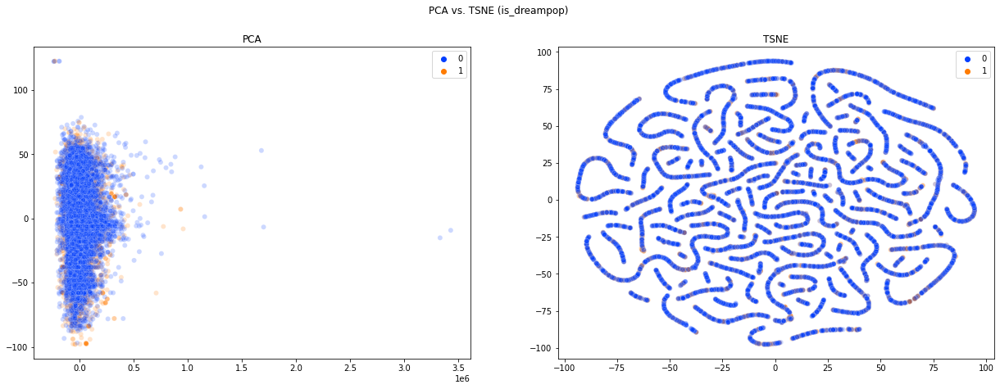

In [8]:
#Graph PCA vs TSNE

fig, axes = plt.subplots(1, 2, figsize=(21, 7))
fig.suptitle('PCA vs. TSNE (is_dreampop)')
axes[0].set_title('PCA')
axes[1].set_title('TSNE')

sns.scatterplot(x=pca[:,0], y=pca[:,1], hue=is_dreampop_int, ax=axes[0], alpha=0.2, palette='bright', legend=True)
sns.scatterplot(x=tsne[:,0], y=tsne[:,1], hue=is_dreampop_int, ax=axes[1], alpha=0.2, palette='bright', legend=True)
plt.show()

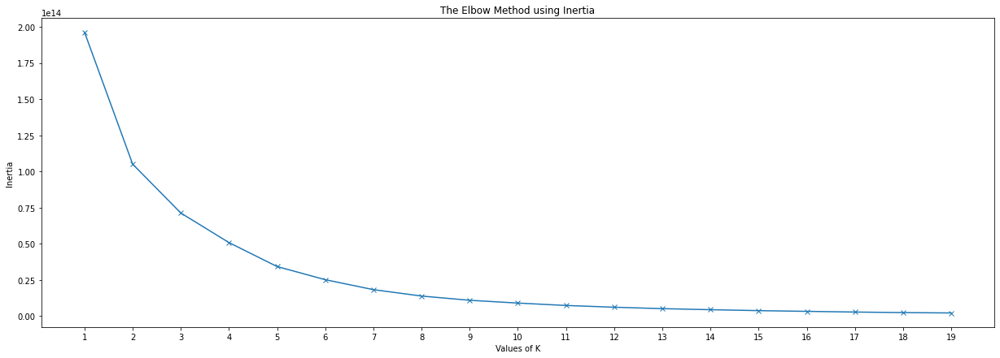

In [9]:
#Elbow Method

inertias = []
mapping1 = {}
mapping2 = {}
K = range(1, 20)
 
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(cluster_data)
    kmeanModel.fit(cluster_data)
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(cluster_data, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / cluster_data.shape[0]
    mapping2[k] = kmeanModel.inertia_

plt.figure(figsize=(21, 7))
plt.plot(K, inertias, '-x')
plt.xlabel('Values of K')
plt.xticks(list(K))
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

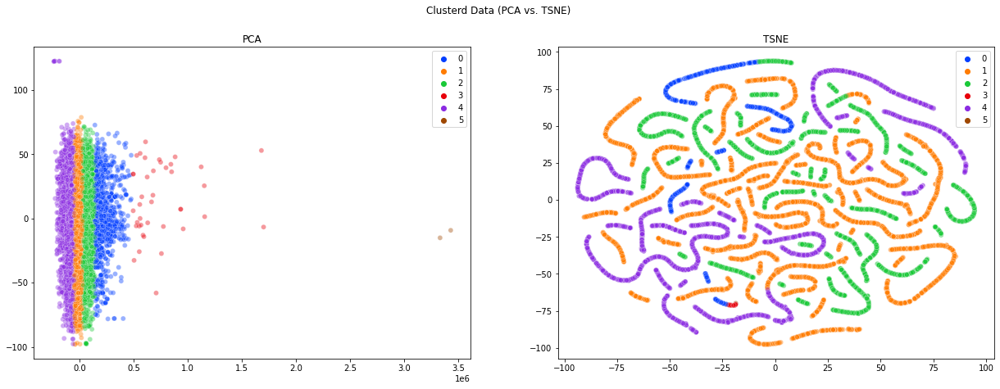

In [10]:
#Cluster Data
n_clusters = 6

kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(cluster_data)
cluster_labels = kmeans.labels_
clustered_data = data.copy()
clustered_data['cluster'] = cluster_labels.tolist()

fig, axes = plt.subplots(1, 2, figsize=(21, 7))
fig.suptitle('Clusterd Data (PCA vs. TSNE)')
axes[0].set_title('PCA')
axes[1].set_title('TSNE')

sns.scatterplot(x=pca[:,0], y=pca[:,1], hue=cluster_labels, ax=axes[0], alpha=0.4, palette='bright')
sns.scatterplot(x=tsne[:,0], y=tsne[:,1], hue=cluster_labels, ax=axes[1], alpha=0.4, palette='bright')
plt.show()